<a href="https://colab.research.google.com/github/BinaryBoortsog/-Sequential-Search/blob/main/Tergel.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Is CUDA available: False
/bin/bash: line 1: nvidia-smi: command not found


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-27 Python-3.10.12 torch-2.5.1+cu121 CPU

Fusing layers... 
YOLOv5l summary: 367 layers, 46533693 parameters, 0 gradients, 109.0 GFLOPs
Adding AutoShape... 


--2024-11-27 07:35:46--  https://dn60005mpuo2f.cloudfront.net/graphics/upo-pages/spring_street_after.jpg
Resolving dn60005mpuo2f.cloudfront.net (dn60005mpuo2f.cloudfront.net)... 3.168.130.60, 3.168.130.136, 3.168.130.221, ...
Connecting to dn60005mpuo2f.cloudfront.net (dn60005mpuo2f.cloudfront.net)|3.168.130.60|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.



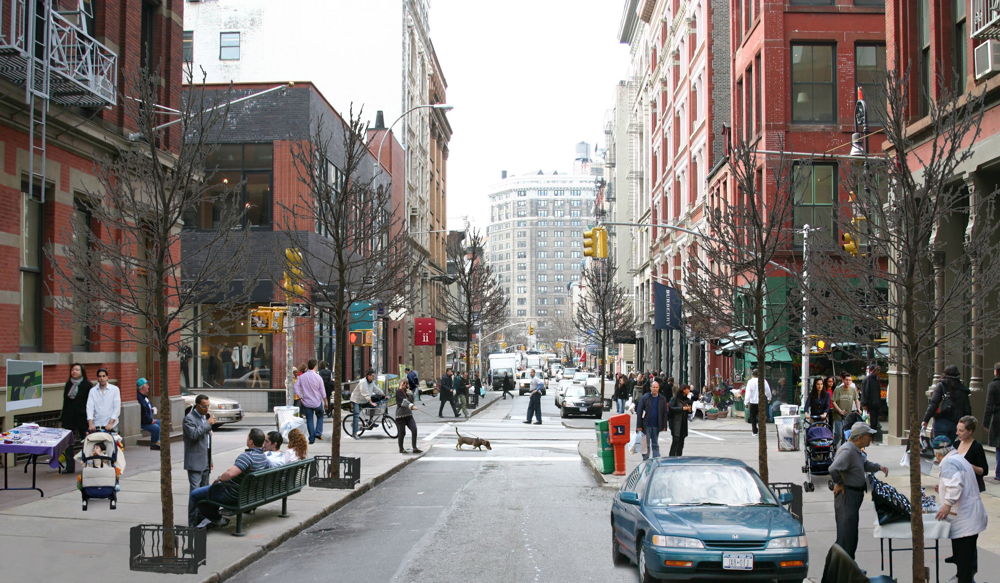

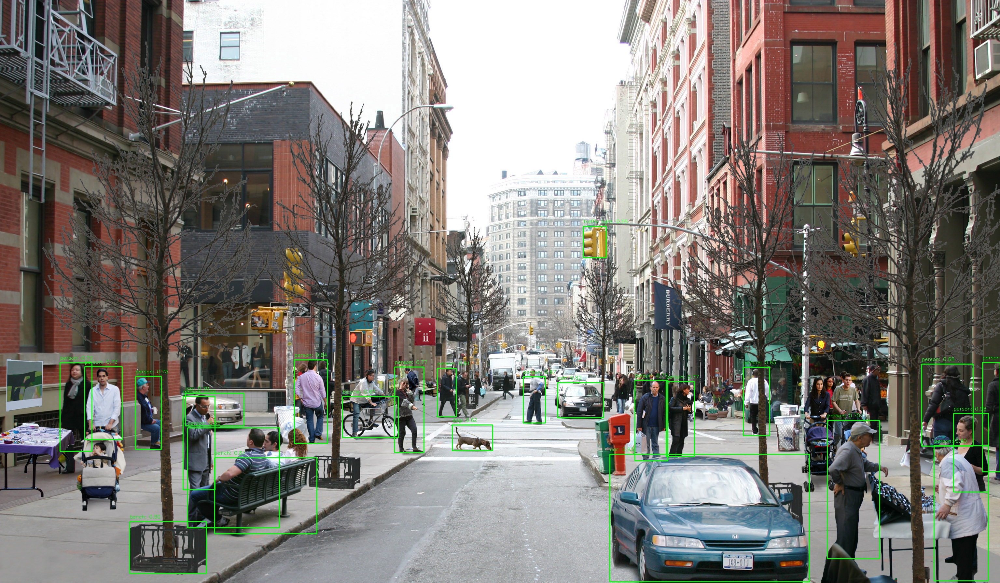

In [ ]:
import numpy as np
import cv2, torch
from google.colab.patches import cv2_imshow

# Check whether GPU is available or not
print("Is CUDA available:", torch.cuda.is_available())
!nvidia-smi

# Load the YOLOv5 model from the Pytorch Hub
yolov5 = torch.hub.load('ultralytics/yolov5', 'yolov5l', pretrained=True)

# Download an image from the internet
!wget -c 'https://dn60005mpuo2f.cloudfront.net/graphics/upo-pages/spring_street_after.jpg' -O 'test2.jpg'

# Load the image
image = cv2.imread('test2.jpg')
cv2_imshow(image)

# Detect objects on the image using YOLOv5
results = yolov5(image)

# Convert results to numpy
objects = results.xyxy[0].detach().cpu().numpy()  # Bounding boxes in format (x_min, y_min, x_max, y_max, confidence, class)

# Get image dimensions
h, w, _ = image.shape

# Define COCO class labels (for YOLOv5 pretrained on COCO)
classes = [
    'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck',
    'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench',
    'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra',
    'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee',
    'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove',
    'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup',
    'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange',
    'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch',
    'potted plant', 'bed', 'dining table', 'toilet', 'TV', 'laptop', 'mouse',
    'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink',
    'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier',
    'toothbrush'
]

# Draw results on the image
for obj in objects:
    confidence = obj[4]
    cls_id = int(obj[5])

    if confidence > 0.5:  # Confidence threshold
        x_min, y_min, x_max, y_max = map(int, obj[:4])  # Bounding box coordinates
        label = f"{classes[cls_id]}: {confidence:.2f}"  # Class label and confidence score

        # Draw bounding box
        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
        # Add label
        cv2.putText(image, label, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

# Show the image with detections
cv2_imshow(image)
